## MNIST

In [1]:
import torch

import torch.optim as optim
import torch.nn.functional as F

from ae import LinearAE
from torch.utils.data import DataLoader
from torchvision.datasets import MNIST
from torchvision import transforms


torch.manual_seed(0)
torch.cuda.manual_seed(0)

trm = transforms.Compose(
    [
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.view(-1)),
    ]
)

train_set = MNIST("data/mnist/", train=True, transform=trm, download=False)
test_set = MNIST("data/mnist/", train=False, transform=trm, download=False)

device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)


init_dim = train_set.data.size(-1) * train_set.data.size(-2)
dims = [init_dim, 1000, 500, 250, 30]
model = LinearAE(dims).to(device)
model.train()

optimizer = optim.AdamW(model.parameters(), lr=5e-4)

batch_size = 64
trainloader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
testloader = DataLoader(test_set, batch_size=batch_size, shuffle=False)

train_loss, eval_loss = [], []
eval_step = train_set.data.size(0) // batch_size // 10
step = 0
latent = {}

for epoch in range(3):
    for im, _ in trainloader:
        im = im.to(device)
        out, z = model(im)

        loss = F.mse_loss(out, im)
        train_loss.append(loss.item())

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

        if step % eval_step == 0 or step + 1 == train_set.data.size(0):
            model.eval()
            zs, ys = [], []

            for im, y in testloader:
                im = im.to(device)

                with torch.no_grad():
                    out, z = model(im)

                zs.append(z)
                ys.append(y)

                loss = F.mse_loss(out, im)
                eval_loss.append(loss.item())

            latent[step] = (torch.cat(zs).detach().cpu(), torch.cat(ys).detach().cpu())
            model.train()

            print(
                f"step {step}: "
                f"train loss = {sum(train_loss) / len(train_loss):.6f} | "
                f"eval loss = {sum(eval_loss) / len(eval_loss):.6f}"
            )

        step += 1

cuda
step 0: train loss = 0.241655 | eval loss = 0.230245
step 93: train loss = 0.048097 | eval loss = 0.128293
step 186: train loss = 0.036341 | eval loss = 0.092120
step 279: train loss = 0.030854 | eval loss = 0.073231
step 372: train loss = 0.027522 | eval loss = 0.061495
step 465: train loss = 0.025180 | eval loss = 0.053479
step 558: train loss = 0.023432 | eval loss = 0.047577
step 651: train loss = 0.022054 | eval loss = 0.043060
step 744: train loss = 0.020926 | eval loss = 0.039494
step 837: train loss = 0.019994 | eval loss = 0.036580
step 930: train loss = 0.019189 | eval loss = 0.034164
step 1023: train loss = 0.018488 | eval loss = 0.032111
step 1116: train loss = 0.017863 | eval loss = 0.030364
step 1209: train loss = 0.017308 | eval loss = 0.028843
step 1302: train loss = 0.016821 | eval loss = 0.027500
step 1395: train loss = 0.016387 | eval loss = 0.026322
step 1488: train loss = 0.016000 | eval loss = 0.025267
step 1581: train loss = 0.015645 | eval loss = 0.024318
s

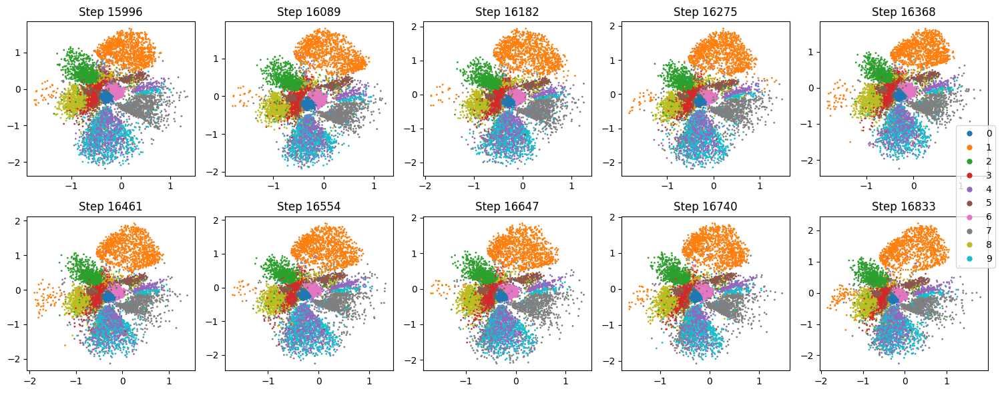

In [4]:
import umap
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

steps = list(latent.keys())[-10:]

fig, axes = plt.subplots(2, 5, figsize=(15, 6))

for ax, step in zip(axes.flatten(), steps):
    z, y = latent[step]

    z2 = z #umap.UMAP(n_neighbors=15, min_dist=0.1).fit_transform(z)

    ax.scatter(
        z2[:, 0],
        z2[:, 1],
        c=y,
        s=1,
        cmap="tab10",
        vmin=0,
        vmax=9,
    )

    ax.set_title(f"Step {step}")

handles = [
    Line2D(
        [0],
        [0],
        marker="o",
        linestyle="",
        markerfacecolor=plt.cm.tab10(i),
        markeredgecolor="none",
        label=str(i),
    )
    for i in range(10)
]

fig.legend(handles=handles, loc="center right")

plt.tight_layout()
plt.show()

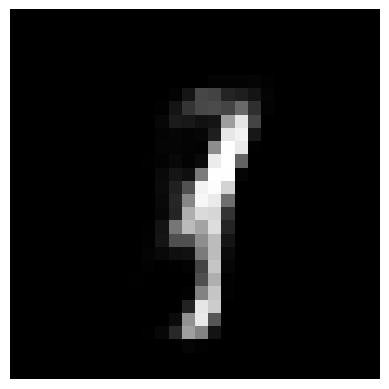

In [2]:
import matplotlib.pyplot as plt

coord = torch.tensor([[-2, -2.4]], dtype=torch.float)  #

model.eval()
with torch.no_grad():
    pred = model.decode(coord.to(device)).cpu()

pred = pred.view(1, 1, 28, 28)

plt.imshow(pred[0, 0], cmap="gray")
plt.axis("off")
plt.show()

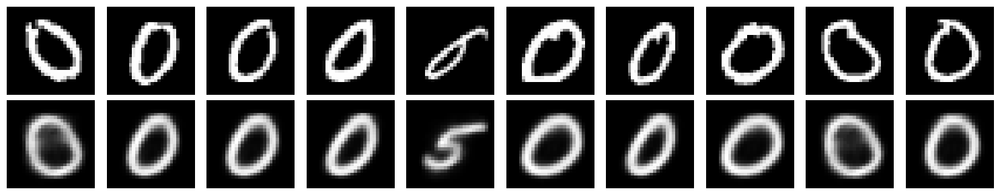

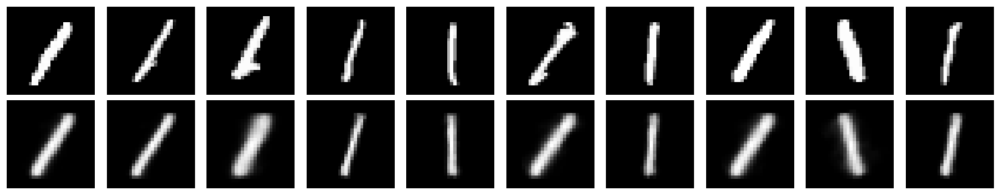

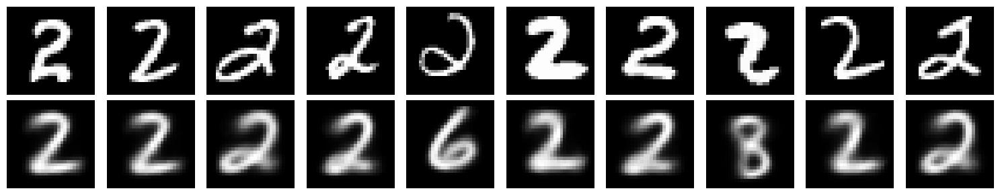

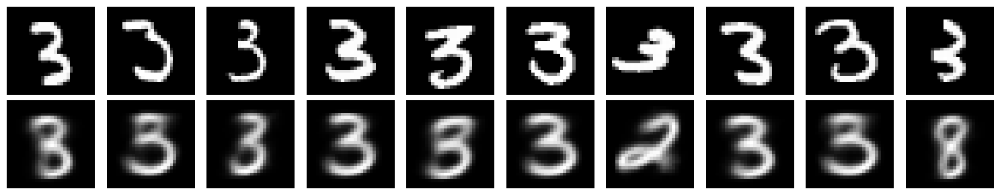

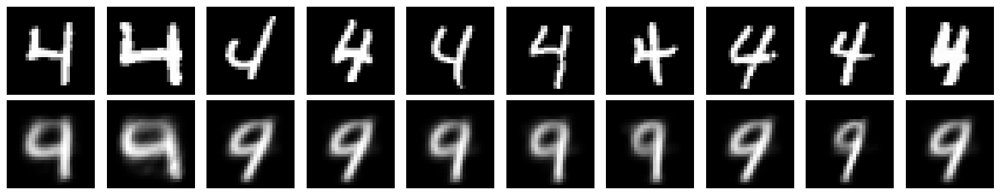

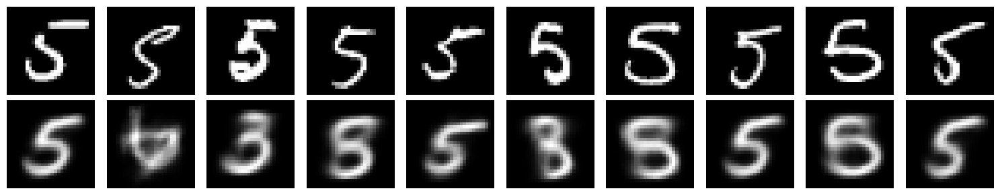

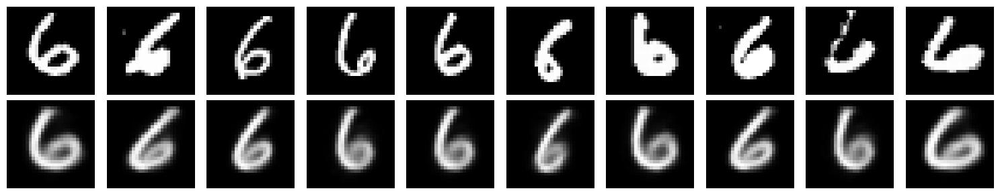

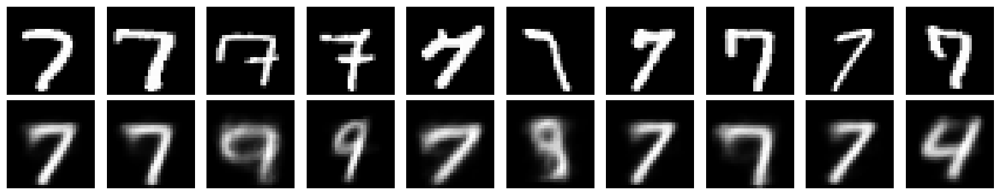

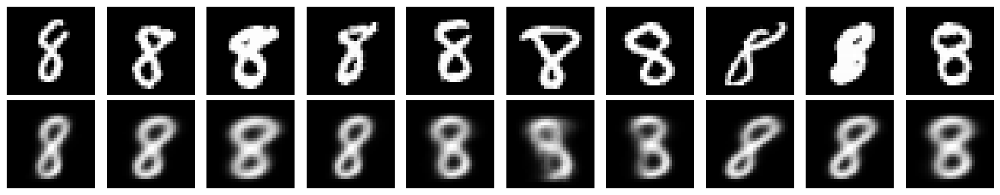

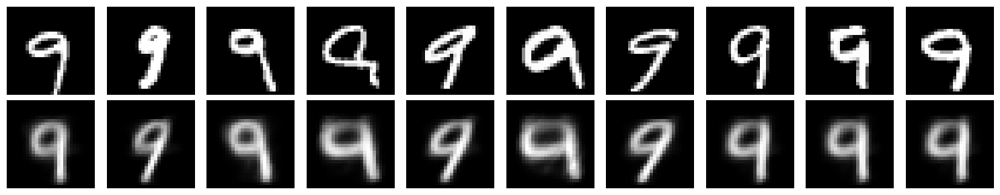

In [3]:
import random
import matplotlib.pyplot as plt

model.eval()

for digit in range(10):
    idxs = [i for i, (_, y) in enumerate(test_set) if y == digit]
    chosen = random.sample(idxs, 10)

    fig, axes = plt.subplots(2, 10, figsize=(15, 3))

    for col, idx in enumerate(chosen):
        image, label = test_set[idx]

        with torch.no_grad():
            rec, _ = model(image.unsqueeze(0).to(device))

        image = image.view(28, 28)  # or (32,32)
        rec = rec.cpu().view(28, 28)

        # input (top row)
        axes[0, col].imshow(image, cmap="gray")
        axes[0, col].axis("off")

        # reconstruction (bottom row)
        axes[1, col].imshow(rec, cmap="gray")
        axes[1, col].axis("off")

    plt.tight_layout()
    plt.show()

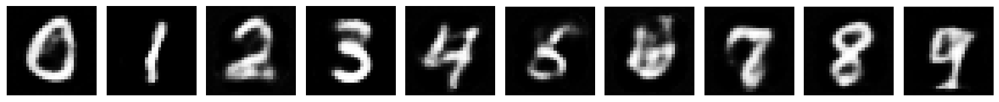

In [12]:
import torch
import matplotlib.pyplot as plt

last_step = list(latent.keys())[-1]
z, y = latent[last_step]
z = z.cpu()
y = y.cpu()

proto = []
for digit in range(10):
    z_d = z[y == digit]  # [Nd, latent_dim]
    mu = torch.median(z_d, dim=0).values  # center
    std = z_d.std(dim=0).clamp_min(1e-3)  # scale

    eps = torch.randn_like(mu)
    proto.append(mu + 0.5 * std * eps)  # <-- randomness

proto = torch.stack(proto, dim=0)  # [10, latent_dim]

model.eval()
with torch.no_grad():
    pred = model.decode(proto.to(device)).cpu()

pred = pred.view(10, 1, 28, 28)

fig, axes = plt.subplots(1, 10, figsize=(15, 2))
for d in range(10):
    axes[d].imshow(pred[d, 0], cmap="gray")
    axes[d].axis("off")

plt.tight_layout()
plt.show()

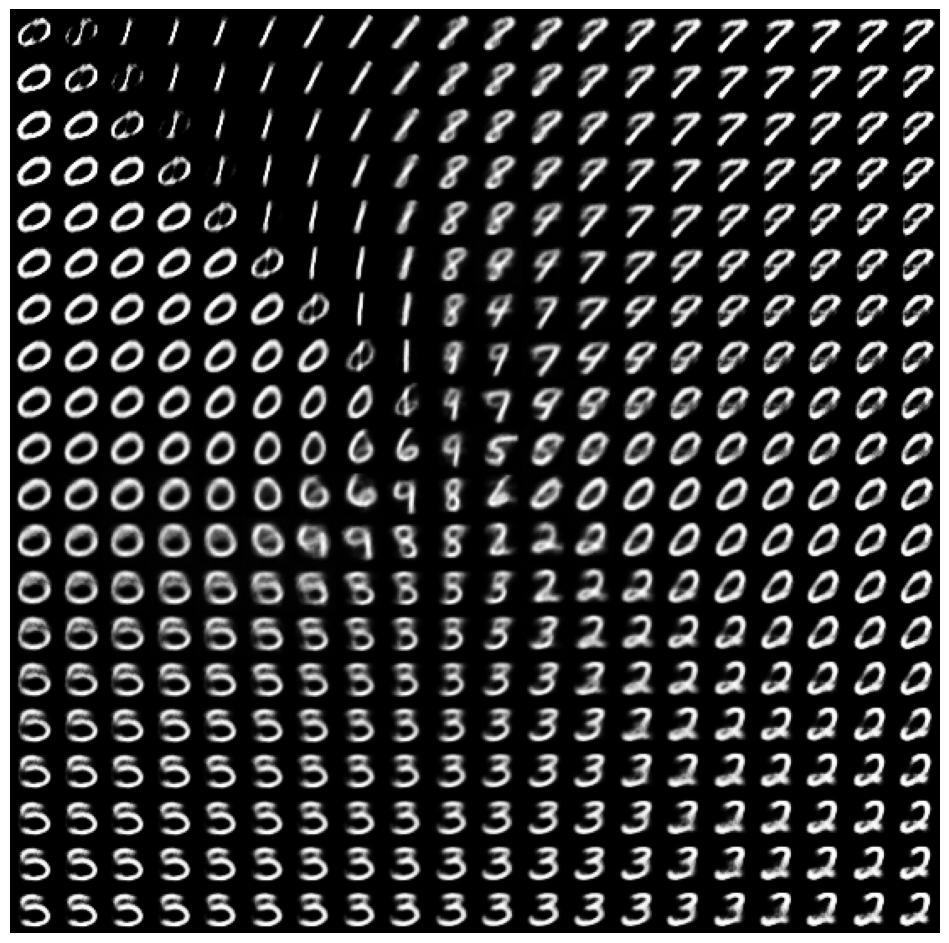

In [4]:
import matplotlib.pyplot as plt


def interpolate_space(
    model,
    x_range=(-3, 3),
    y_range=(-3, 3),
    num_steps=20,
    img_shape=(1, 28, 28),
    device="cuda",
):
    model.eval()

    # Build a num_steps x num_steps grid in latent space (no numpy)
    xs = torch.linspace(x_range[0], x_range[1], num_steps, device=device)
    ys = torch.linspace(y_range[0], y_range[1], num_steps, device=device)
    yy, xx = torch.meshgrid(ys, xs, indexing="ij")  # shapes: (num_steps, num_steps)
    points = torch.stack([xx, yy], dim=-1).reshape(-1, 2)  # shape: (num_steps^2, 2)

    with torch.no_grad():
        pred = model.decode(points)  # (num_steps^2, prod(img_shape))

    # Turn flat vectors into (C,H,W) images
    pred = pred.reshape(num_steps, num_steps, *img_shape).detach().cpu()

    fig, ax = plt.subplots(num_steps, num_steps, figsize=(12, 12))
    for i in range(num_steps):
        for j in range(num_steps):
            img = pred[i, j]
            if img.shape[0] == 1:
                ax[i, j].imshow(img[0], cmap="gray")
            else:
                ax[i, j].imshow(img.permute(1, 2, 0))  # still torch tensor
            ax[i, j].axis("off")

    fig.subplots_adjust(wspace=0, hspace=0)
    plt.show()


interpolate_space(model)

In [1]:
import torch

import torch.optim as optim
import torch.nn.functional as F

from ae import ConvAE
from torch.utils.data import DataLoader
from torchvision.datasets import MNIST
from torchvision import transforms

torch.manual_seed(0)
torch.cuda.manual_seed(0)

trm = transforms.Compose(
    [
        transforms.ToTensor(),
        # transforms.Lambda(lambda x: x.view(-1)),
    ]
)

train_set = MNIST("data/mnist/", train=True, transform=trm, download=False)
test_set = MNIST("data/mnist/", train=False, transform=trm, download=False)

train_loader = DataLoader(train_set, batch_size=64, shuffle=True)
test_loader = DataLoader(test_set, batch_size=64, shuffle=False)

device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)


model = ConvAE([1, 32, 64]).to(device)
model.train()

optimizer = optim.AdamW(model.parameters(), lr=1e-3)

batch_size = 64

train_loss, eval_loss = [], []
eval_step = train_set.data.shape[0] // batch_size // 10
step = 0
latent = {}

for epoch in range(1):
    for im, _ in train_loader:
        im = im.to(device)
        out, z = model(im)

        loss = F.mse_loss(out, im)
        train_loss.append(loss.item())

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

        if step % eval_step == 0:
            model.eval()
            zs, ys = [], []

            for im, y in test_loader:
                im = im.to(device)

                with torch.no_grad():
                    out, z = model(im)

                zs.append(z)
                ys.append(y)

                loss = F.mse_loss(out, im)
                eval_loss.append(loss.item())

            latent[step] = (torch.cat(zs).detach().cpu(), torch.cat(ys).detach().cpu())
            model.train()

            print(
                f"step {step}: "
                f"train loss = {sum(train_loss) / len(train_loss):.6f} | "
                f"eval loss = {sum(eval_loss) / len(eval_loss):.6f}"
            )

        step += 1

cuda
step 0: train loss = 0.253540 | eval loss = 0.230496
step 93: train loss = 0.048750 | eval loss = 0.121948
step 186: train loss = 0.028255 | eval loss = 0.082754
step 279: train loss = 0.019927 | eval loss = 0.062665
step 372: train loss = 0.015450 | eval loss = 0.050453
step 465: train loss = 0.012656 | eval loss = 0.042254
step 558: train loss = 0.010744 | eval loss = 0.036365
step 651: train loss = 0.009346 | eval loss = 0.031926
step 744: train loss = 0.008279 | eval loss = 0.028462
step 837: train loss = 0.007441 | eval loss = 0.025682
step 930: train loss = 0.006764 | eval loss = 0.023405


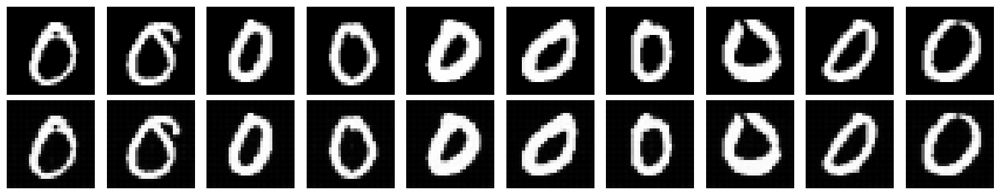

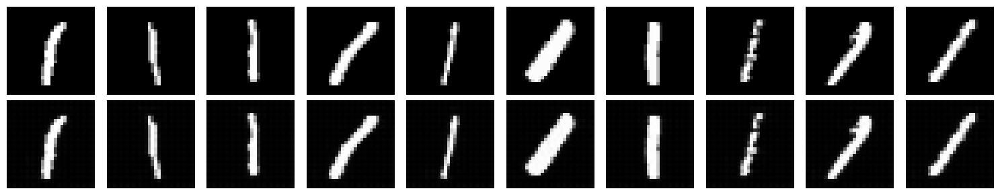

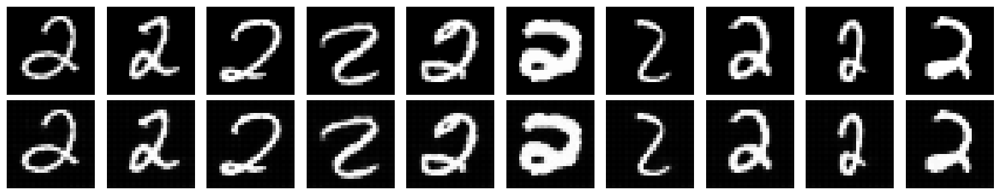

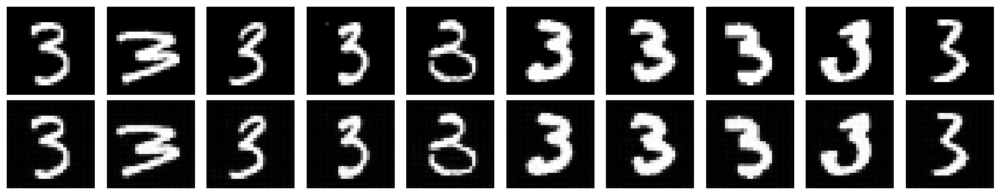

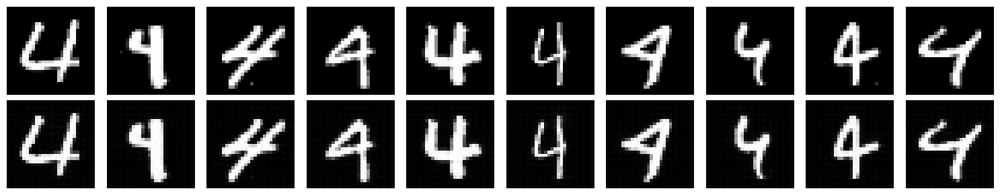

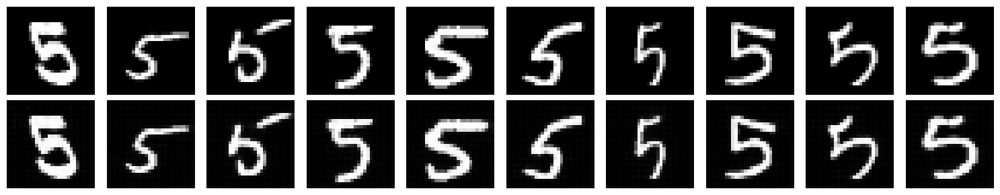

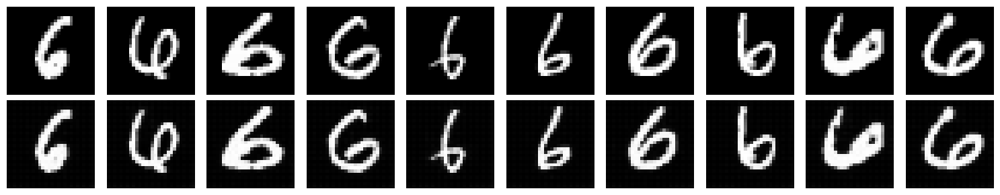

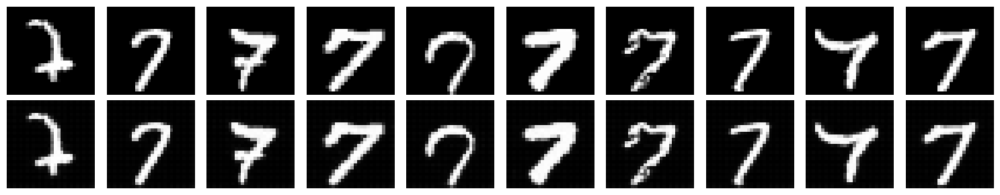

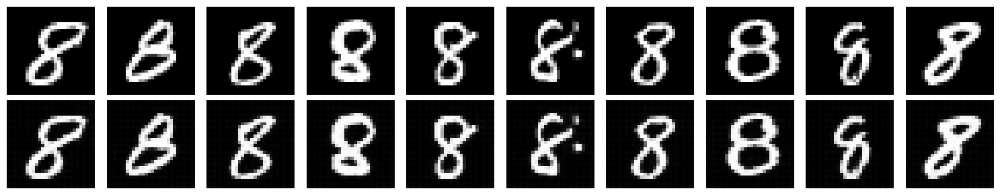

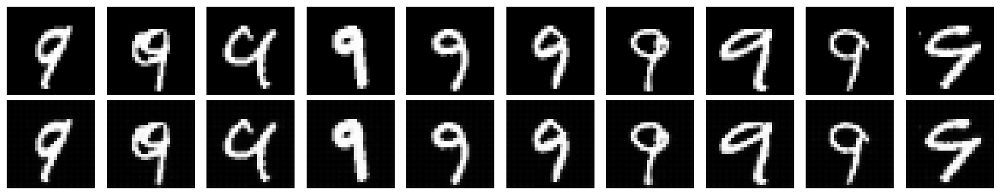

In [2]:
import random
import matplotlib.pyplot as plt

model.eval()

for digit in range(10):
    idxs = [i for i, (_, y) in enumerate(test_set) if y == digit]
    chosen = random.sample(idxs, 10)

    fig, axes = plt.subplots(2, 10, figsize=(15, 3))

    for col, idx in enumerate(chosen):
        image, label = test_set[idx]

        with torch.no_grad():
            rec, _ = model(image.unsqueeze(0).to(device))

        image = image.view(28, 28)  # or (32,32)
        rec = rec.cpu().view(28, 28)

        # input (top row)
        axes[0, col].imshow(image, cmap="gray")
        axes[0, col].axis("off")

        # reconstruction (bottom row)
        axes[1, col].imshow(rec, cmap="gray")
        axes[1, col].axis("off")

    plt.tight_layout()
    plt.show()

## STL10

In [1]:
from torchvision.datasets import STL10
from torchvision import transforms

trm = transforms.Compose(
    [
        transforms.ToTensor(),
    ]
)

train_set = STL10(root="data/stl10", split="train", download=False, transform=trm)

test_set = STL10(root="data/stl10", split="test", download=False, transform=trm)

print(train_set.data.shape)

(5000, 3, 96, 96)


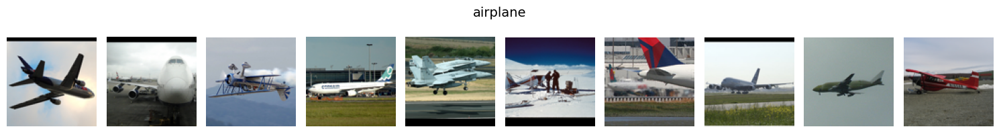

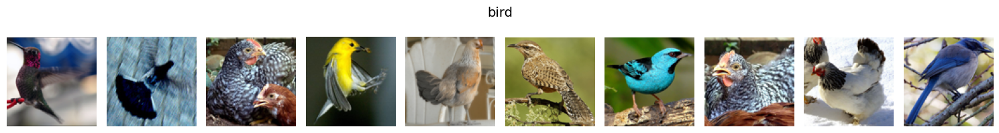

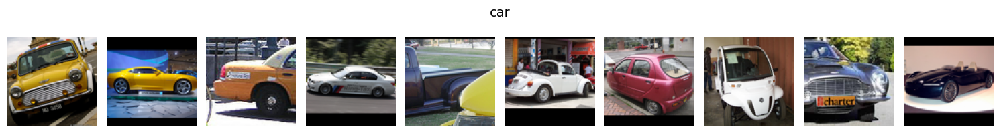

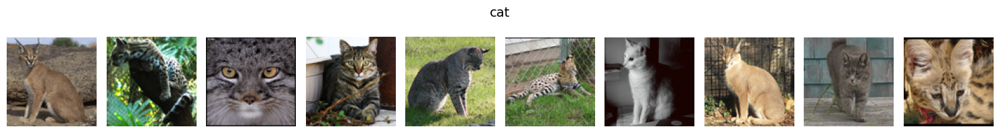

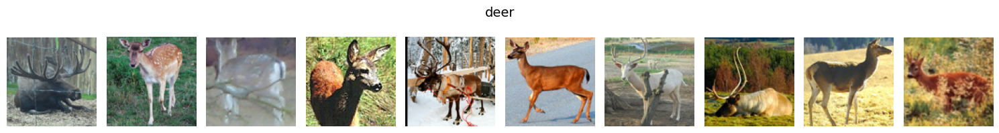

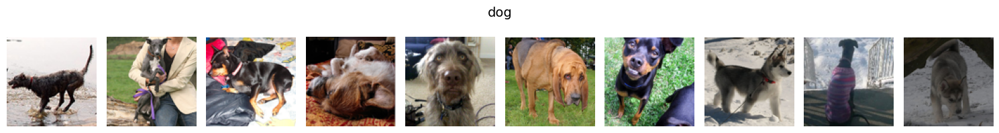

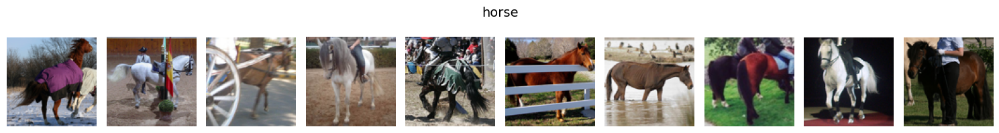

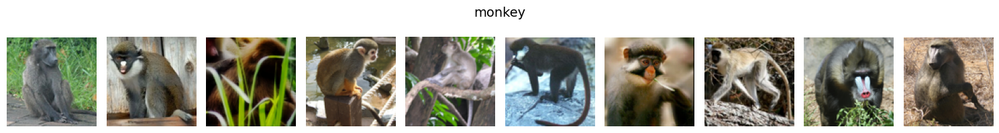

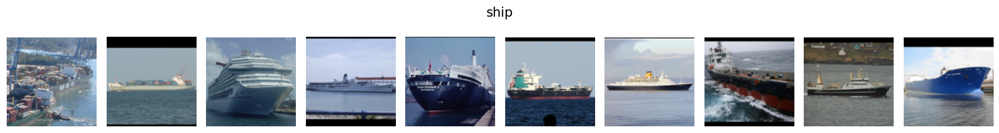

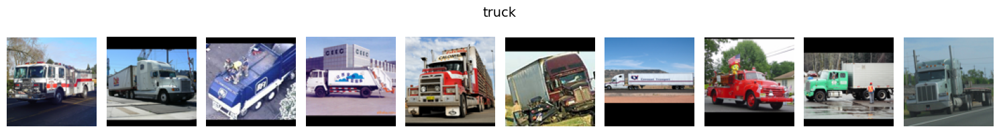

In [2]:
import matplotlib.pyplot as plt
import random

for cls in range(10):
    idxs = [i for i, (_, y) in enumerate(train_set) if y == cls]
    chosen = random.sample(idxs, 10)

    fig, axes = plt.subplots(1, 10, figsize=(15, 2))

    for j, idx in enumerate(chosen):
        img, _ = train_set[idx]
        img = img.permute(1, 2, 0)  # CHW -> HWC

        axes[j].imshow(img)
        axes[j].axis("off")

    fig.suptitle(train_set.classes[cls], fontsize=14)
    plt.tight_layout()
    plt.show()

In [ ]:
import torch

import torch.optim as optim
import torch.nn.functional as F


from ae import LinearAE
from torch.utils.data import DataLoader


torch.manual_seed(0)
torch.cuda.manual_seed(0)

from torchvision.datasets import STL10
from torchvision import transforms

trm = transforms.Compose(
    [
        transforms.ToTensor(),
    ]
)

train_set = STL10(root="data/stl10", split="train", download=False, transform=trm)

test_set = STL10(root="data/stl10", split="test", download=False, transform=trm)

train_loader = DataLoader(train_set, batch_size=64, shuffle=True)
test_loader = DataLoader(test_set, batch_size=64, shuffle=False)

device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)


init_dim = (
    train_set.data.shape[-1] * train_set.data.shape[-2] * train_set.data.shape[-3]
)
model = LinearAE([init_dim, 1000, 500, 250, 125, 60]).to(device)
model.train()

optimizer = optim.AdamW(model.parameters(), lr=1e-3)

batch_size = 64
trainloader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
testloader = DataLoader(test_set, batch_size=batch_size, shuffle=False)

train_loss, eval_loss = [], []
eval_step = train_set.data.shape[0] // batch_size // 10
step = 0
latent = {}

for epoch in range(1):
    for im, _ in trainloader:
        im = im.to(device)
        im = im.flatten(1)
        out, z = model(im)

        # loss = F.mse_loss(out, im)
        loss = F.l1_loss(out, im)
        train_loss.append(loss.item())

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

        if step % eval_step == 0 or step + 1 == train_set.data.shape[0]:
            model.eval()
            zs, ys = [], []

            for im, y in testloader:
                im = im.to(device)
                im = im.flatten(1)

                with torch.no_grad():
                    out, z = model(im)

                zs.append(z)
                ys.append(y)

                # loss = F.mse_loss(out, im)
                loss = F.l1_loss(out, im)
                eval_loss.append(loss.item())

            latent[step] = (torch.cat(zs).detach().cpu(), torch.cat(ys).detach().cpu())
            model.train()

            print(
                f"step {step}: "
                f"train loss = {sum(train_loss) / len(train_loss):.6f} | "
                f"eval loss = {sum(eval_loss) / len(eval_loss):.6f}"
            )

        step += 1

cuda
step 0: train loss = 0.247391 | eval loss = 0.226630
step 7: train loss = 0.216889 | eval loss = 0.332520
step 14: train loss = 0.209018 | eval loss = 0.361001
step 21: train loss = 0.202774 | eval loss = 0.351281
step 28: train loss = 0.197259 | eval loss = 0.331824
step 35: train loss = 0.194309 | eval loss = 0.311772
step 42: train loss = 0.192874 | eval loss = 0.298187
step 49: train loss = 0.190972 | eval loss = 0.285459


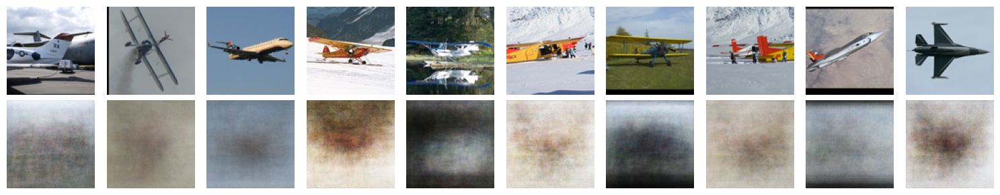

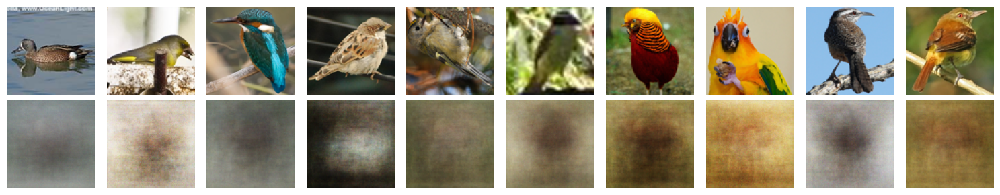

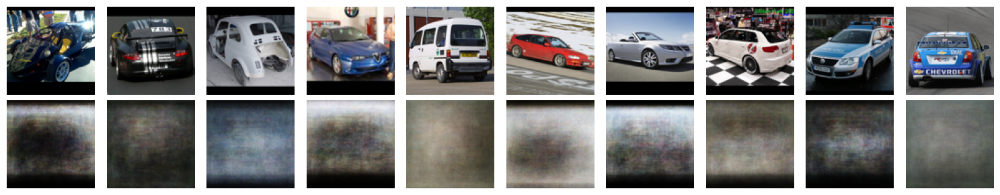

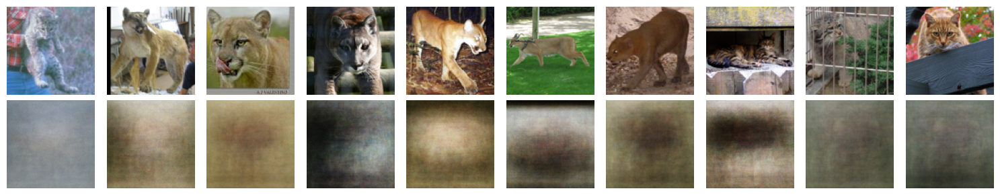

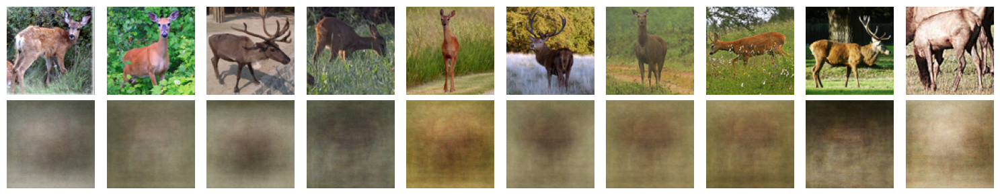

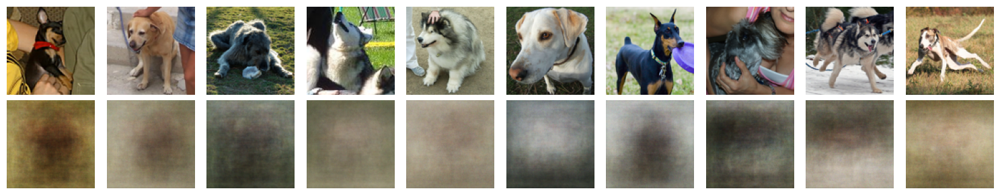

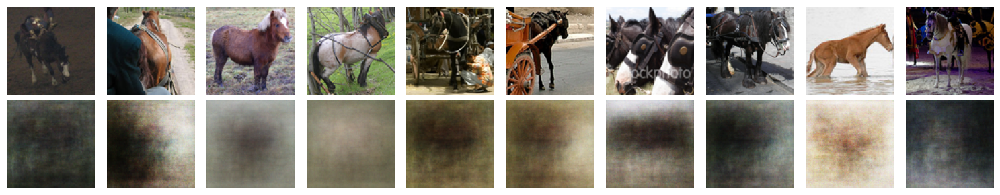

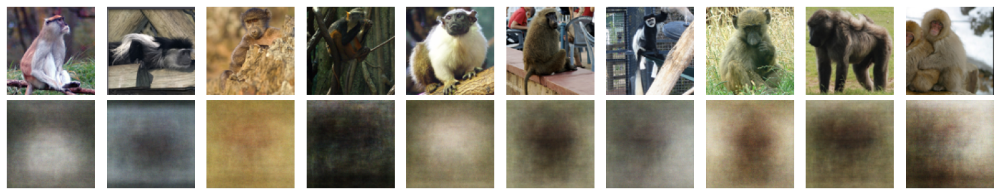

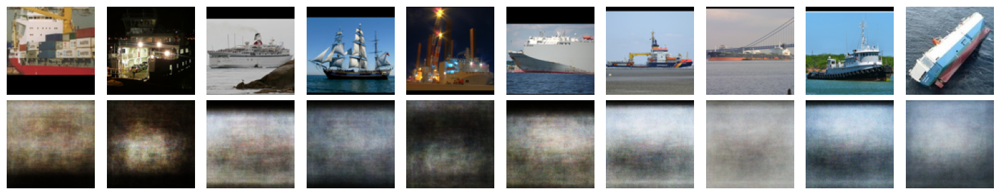

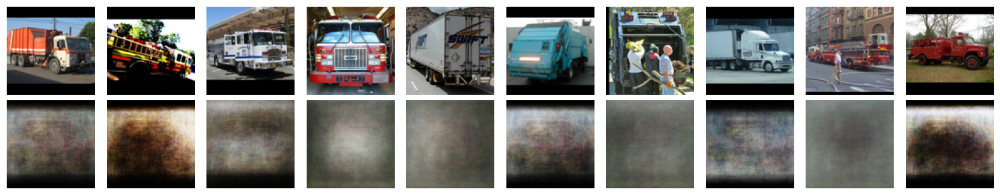

In [2]:
import random
import matplotlib.pyplot as plt

model.eval()

for cls in range(10):
    idxs = [i for i, (_, y) in enumerate(test_set) if y == cls]
    chosen = random.sample(idxs, 10)

    fig, axes = plt.subplots(2, 10, figsize=(15, 3))

    for col, idx in enumerate(chosen):
        im, y = test_set[idx]
        im = im.flatten()

        with torch.no_grad():
            rec, _ = model(im.unsqueeze(0).to(device))

        im = im.view(3, 96, 96).permute(1, 2, 0)  # -> (96, 96, 3)
        rec = rec.squeeze(0).cpu().view(3, 96, 96).permute(1, 2, 0)  # .clamp(0, 1)

        # input (top row)
        axes[0, col].imshow(im)
        axes[0, col].axis("off")

        # reconstruction (bottom row)
        axes[1, col].imshow(rec)
        axes[1, col].axis("off")

    plt.tight_layout()
    plt.show()

In [1]:
import torch
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torchvision.datasets import STL10
from torchvision import transforms

from ae import ConvAE

torch.manual_seed(0)
torch.cuda.manual_seed(0)

trm = transforms.Compose([transforms.ToTensor()])

train_set = STL10("data/stl10", split="train", download=False, transform=trm)
test_set = STL10("data/stl10", split="test", download=False, transform=trm)

trainloader = DataLoader(train_set, batch_size=64, shuffle=True)
testloader = DataLoader(test_set, batch_size=64, shuffle=False)

device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

# 96x96 -> 48 -> 24 -> 12 -> 6 -> 3 after 5 stride-2 convs
model = ConvAE([3, 32, 64, 128, 256]).to(device)
optimizer = optim.AdamW(model.parameters(), lr=1e-3)

train_loss, eval_loss = [], []
eval_step = len(trainloader) // 10
step = 0
latent = {}

for epoch in range(3):
    model.train()
    for im, _ in trainloader:
        im = im.to(device)
        out, z = model(im)

        loss = F.mse_loss(out, im)
        train_loss.append(loss.item())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if step % eval_step == 0:
            model.eval()
            zs, ys = [], []

            with torch.no_grad():
                for im, y in testloader:
                    im = im.to(device)
                    out, z = model(im)

                    zs.append(z.cpu())
                    ys.append(y)

                    loss = F.mse_loss(out, im)

                    eval_loss.append(loss.item())

            latent[step] = (torch.cat(zs), torch.cat(ys))
            model.train()

            print(
                f"step {step}: "
                f"train loss = {sum(train_loss) / len(train_loss):.6f} | "
                f"eval loss = {sum(eval_loss) / len(eval_loss):.6f}"
            )

        step += 1

cuda
step 0: train loss = 0.097375 | eval loss = 0.073998
step 7: train loss = 0.069445 | eval loss = 0.072442
step 14: train loss = 0.058323 | eval loss = 0.067956
step 21: train loss = 0.051156 | eval loss = 0.061587
step 28: train loss = 0.045556 | eval loss = 0.055337
step 35: train loss = 0.041351 | eval loss = 0.050288
step 42: train loss = 0.038086 | eval loss = 0.046041
step 49: train loss = 0.035480 | eval loss = 0.042673
step 56: train loss = 0.033315 | eval loss = 0.039917
step 63: train loss = 0.031566 | eval loss = 0.037623
step 70: train loss = 0.030164 | eval loss = 0.035680
step 77: train loss = 0.028875 | eval loss = 0.034097
step 84: train loss = 0.027736 | eval loss = 0.032716
step 91: train loss = 0.026810 | eval loss = 0.031488
step 98: train loss = 0.025978 | eval loss = 0.030356
step 105: train loss = 0.025257 | eval loss = 0.029347
step 112: train loss = 0.024534 | eval loss = 0.028428
step 119: train loss = 0.023863 | eval loss = 0.027643
step 126: train loss =

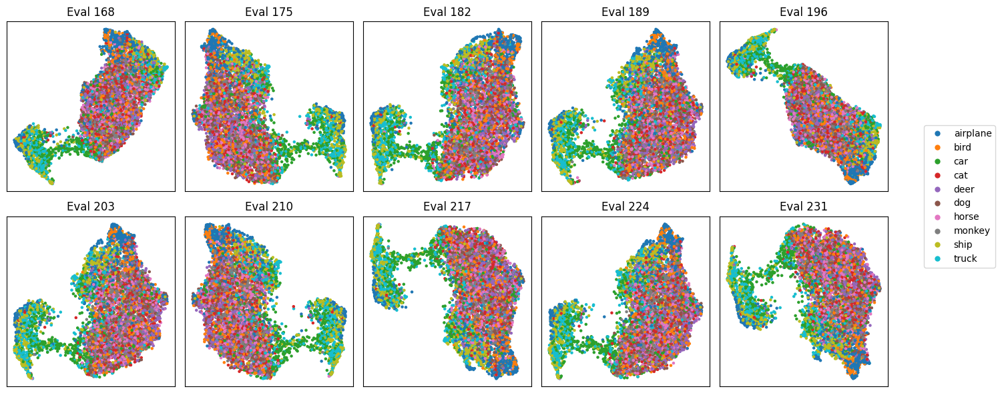

In [4]:
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import umap

steps = list(latent.keys())[-10:]

fig, axes = plt.subplots(2, 5, figsize=(15, 6))

for ax, step in zip(axes.flatten(), steps):
    z, y = latent[step]  # z: [N, C, H, W]

    z_flat = z.view(z.size(0), -1)
    z2 = umap.UMAP(n_neighbors=15, min_dist=0.1).fit_transform(z_flat)

    ax.scatter(
        z2[:, 0],
        z2[:, 1],
        c=y,
        s=5,
        cmap="tab10",
        vmin=0,
        vmax=9,
    )

    ax.set_title(f"Eval {step}")
    ax.set_xticks([])
    ax.set_yticks([])

handles = [
    Line2D(
        [0],
        [0],
        marker="o",
        linestyle="",
        markerfacecolor=plt.cm.tab10(i),
        markeredgecolor="none",
        markersize=6,
        label=test_set.classes[i],
    )
    for i in range(10)
]

fig.legend(handles=handles, loc="center right")
plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.show()

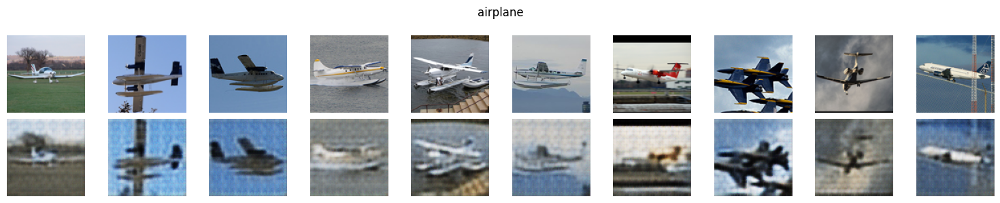

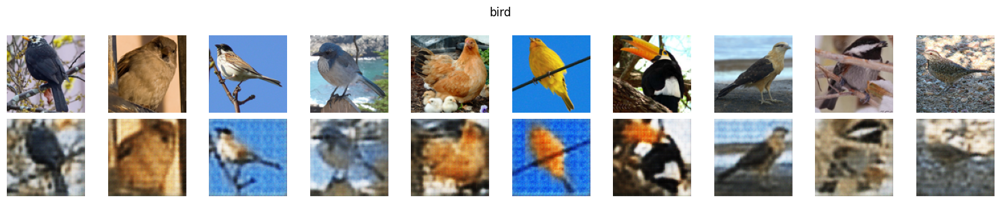

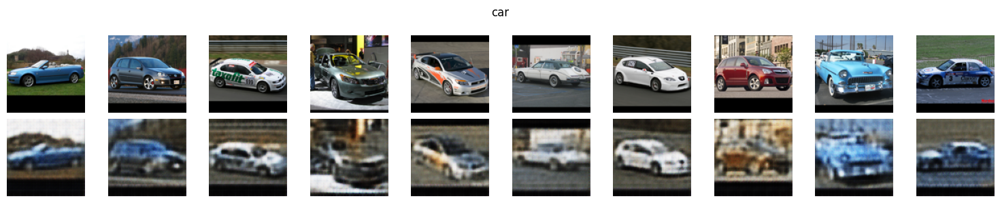

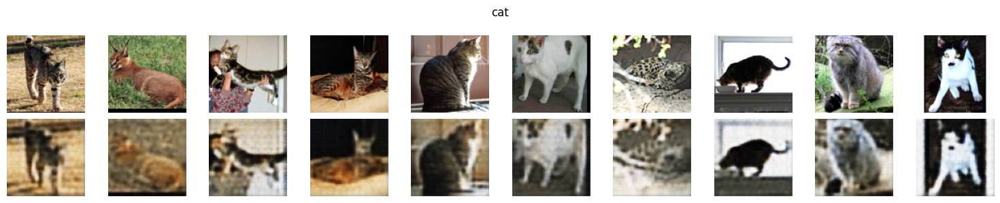

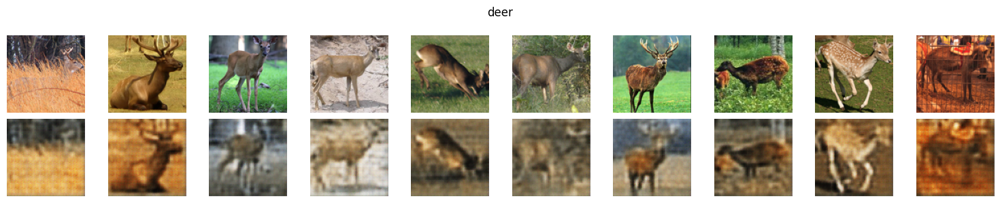

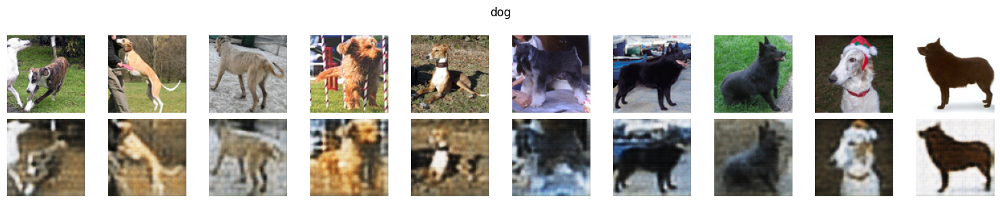

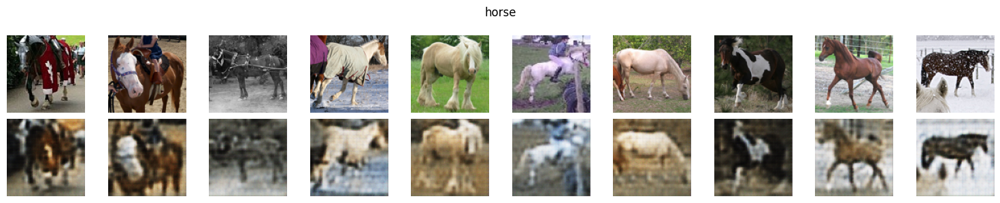

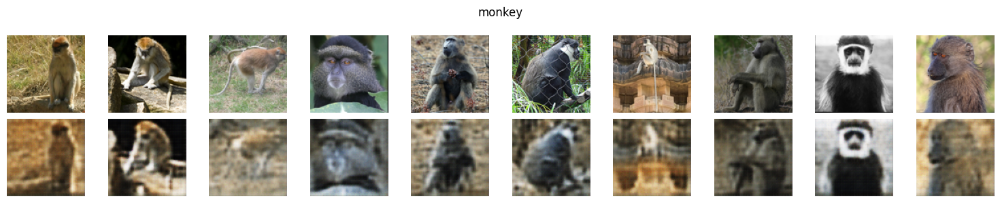

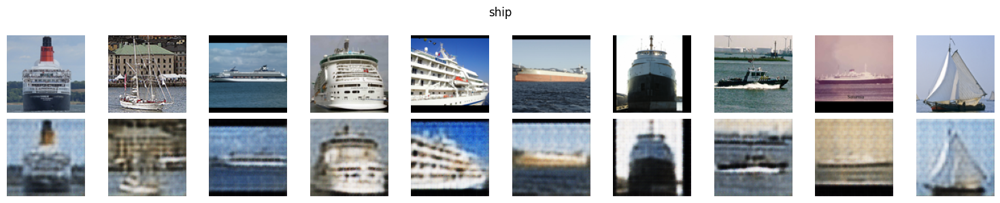

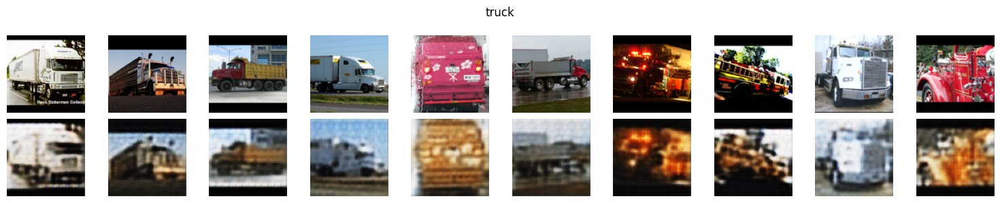

In [2]:
import random
import matplotlib.pyplot as plt
import torch

model.eval()

for cls in range(10):
    idxs = [i for i, (_, y) in enumerate(test_set) if y == cls]
    chosen = random.sample(idxs, 10)

    fig, axes = plt.subplots(2, 10, figsize=(15, 3))
    fig.suptitle(test_set.classes[cls])

    for col, idx in enumerate(chosen):
        im, y = test_set[idx]  # im: [3, 96, 96]

        with torch.no_grad():
            rec, _ = model(im.unsqueeze(0).to(device))  # no flatten

        # convert to HWC for plotting
        im_plot = im.permute(1, 2, 0)  # [96, 96, 3]
        rec_plot = rec.squeeze(0).cpu().permute(1, 2, 0).clamp(0, 1)

        # input (top row)
        axes[0, col].imshow(im_plot)
        axes[0, col].axis("off")

        # reconstruction (bottom row)
        axes[1, col].imshow(rec_plot)
        axes[1, col].axis("off")

    plt.tight_layout()
    plt.show()

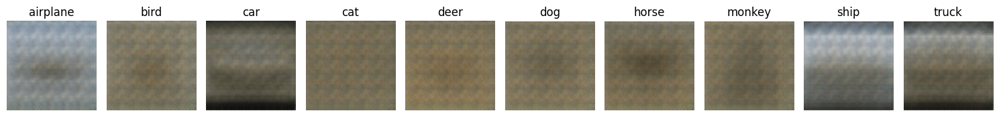

In [3]:
import torch
import matplotlib.pyplot as plt

last_step = list(latent.keys())[-1]
z, y = latent[last_step]  # z: [N, C, H, W], y: [N]
z = z.cpu()
y = y.cpu()

proto = []
for cls in range(10):
    z_c = z[y == cls]  # [Nc, C, H, W]
    proto.append(torch.median(z_c, dim=0).values)

proto = torch.stack(proto, dim=0)  # [10, C, H, W]

model.eval()
with torch.no_grad():
    pred = model.decode(proto.to(device)).cpu()  # [10, 3, 96, 96]

fig, axes = plt.subplots(1, 10, figsize=(15, 2))
for i in range(10):
    img = pred[i].permute(1, 2, 0).clamp(0, 1)  # CHW -> HWC
    axes[i].imshow(img)
    axes[i].set_title(test_set.classes[i])
    axes[i].axis("off")

plt.tight_layout()
plt.show()